# STAX outperforms state-of-the-art (SOTA) methods in benchmark datasets for single-omics spatial domain identification

## Load package

In [1]:
import warnings
warnings.filterwarnings("ignore")

In [2]:
import sys
print(sys.path)
sys.path.append('E:\\学习\\6科研\\论文\\博士论文\\STAX\\code')

['C:\\Users\\10360\\anaconda3\\envs\\py311\\python311.zip', 'C:\\Users\\10360\\anaconda3\\envs\\py311\\DLLs', 'C:\\Users\\10360\\anaconda3\\envs\\py311\\Lib', 'C:\\Users\\10360\\anaconda3\\envs\\py311', '', 'C:\\Users\\10360\\AppData\\Roaming\\Python\\Python311\\site-packages', 'C:\\Users\\10360\\anaconda3\\envs\\py311\\Lib\\site-packages', 'C:\\Users\\10360\\anaconda3\\envs\\py311\\Lib\\site-packages\\win32', 'C:\\Users\\10360\\anaconda3\\envs\\py311\\Lib\\site-packages\\win32\\lib', 'C:\\Users\\10360\\anaconda3\\envs\\py311\\Lib\\site-packages\\Pythonwin']


In [3]:
import scanpy as sc
import pandas as pd
import numpy as np
import torch
import dgl
import random
from scipy.sparse import csr_matrix
from sklearn.metrics import adjusted_rand_score as ari_score
from sklearn.metrics.cluster import normalized_mutual_info_score

In [4]:
import STA as sta

In [5]:
seed = 42
random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
np.random.seed(seed)
dgl.random.seed(seed)

In [6]:
sc.set_figure_params(dpi=300, figsize=(4, 4), frameon=False)    # TODO 是否画边框

## Epigenomics, mouse_brain_dataset_1

### Load data

In [7]:
adata1 = sc.read_h5ad(f'./data/1single/mouse_brain_dataset_1.h5ad')
adata1
# sc.pp.subsample(adata1, n_obs=10000)
adata1.obs_names_make_unique()
adata1.var_names_make_unique()
adata1

AnnData object with n_obs × n_vars = 9215 × 121068
    obs: 'nCount_Spatial', 'nFeature_Spatial', 'nCount_SCT', 'nFeature_SCT', 'nCount_ATAC', 'nFeature_ATAC', 'nCount_peaks', 'nFeature_peaks', 'RNA_clusters', 'ATAC_clusters'
    var: 'count', 'percentile'
    uns: 'ATAC', 'ATAC_clusters_colors', 'umap'
    obsm: 'X_lsi', 'X_pca', 'X_umap', 'spatial'
    obsp: 'ATAC_connectivities', 'ATAC_distances'

### Here, we use LSI to preprocess peaks matrix

In [8]:
sta.pp.lsi(adata1, n_components=50)

In [9]:
adata1_new = sc.AnnData(adata1.obsm['X_lsi'], obs=adata1.obs, obsm=adata1.obsm)
adata1_new

AnnData object with n_obs × n_vars = 9215 × 49
    obs: 'nCount_Spatial', 'nFeature_Spatial', 'nCount_SCT', 'nFeature_SCT', 'nCount_ATAC', 'nFeature_ATAC', 'nCount_peaks', 'nFeature_peaks', 'RNA_clusters', 'ATAC_clusters'
    obsm: 'X_lsi', 'X_pca', 'X_umap', 'spatial'

In [10]:
data_list = [adata1_new]
batch_key = 'batch'
batch_names = ['adata1_new']

adata = sta.pp.process_adata(data_list, label=batch_key, keys=batch_names, norm=False, scale='minmax', target_sum=1e4)
adata

AnnData object with n_obs × n_vars = 9215 × 49
    obs: 'nCount_Spatial', 'nFeature_Spatial', 'nCount_SCT', 'nFeature_SCT', 'nCount_ATAC', 'nFeature_ATAC', 'nCount_peaks', 'nFeature_peaks', 'RNA_clusters', 'ATAC_clusters', 'original_index', 'spot_quality', 'batch'
    obsm: 'X_lsi', 'X_pca', 'X_umap', 'spatial'
    layers: 'counts'

### Construct graph

In [11]:
rad_cutoff_list = [6]
adata, g = sta.pp.process_graph(adata, data_list, cutoff_list=rad_cutoff_list, model='KNN')

cal spatial net in data_list
------Calculating spatial graph...
The graph contains 55290 edges, 9215 cells.
6.0000 neighbors per cell on average.


### Train

In [12]:
path_results = f'./log/ATAC_mouse_brain/'

In [13]:
adata_STAX = sta.model.STAX(adata=adata,
                            n_epoch=500,
                            batch_size=len(adata),
                            verbose=False,
                            gpu=0,
                            random_seed=42,
                            output_dir=path_results,
                            )

Epochs: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [00:15<00:00, 32.49it/s, recon_loss_mse=246.5329, kl_loss=4.4642, lr: 0.0]


In [14]:
adata_STAX

AnnData object with n_obs × n_vars = 9215 × 49
    obs: 'nCount_Spatial', 'nFeature_Spatial', 'nCount_SCT', 'nFeature_SCT', 'nCount_ATAC', 'nFeature_ATAC', 'nCount_peaks', 'nFeature_peaks', 'RNA_clusters', 'ATAC_clusters', 'original_index', 'spot_quality', 'batch'
    uns: 'adj'
    obsm: 'X_lsi', 'X_pca', 'X_umap', 'spatial', 'X_STAX'
    varm: 'gene_embedding'
    layers: 'counts', 'impute'

### Clustering

In [15]:
sc.pp.neighbors(adata_STAX, use_rep='X_STAX')
sc.tl.umap(adata_STAX)

In [16]:
sc.tl.louvain(adata_STAX, resolution=0.7)

In [17]:
sc.tl.leiden(adata_STAX, resolution=0.6)

In [18]:
sta.tl.mclust_R(adata_STAX, used_embedding='X_STAX', n_clusters=10)

R[write to console]:                    __           __ 
   ____ ___  _____/ /_  _______/ /_
  / __ `__ \/ ___/ / / / / ___/ __/
 / / / / / / /__/ / /_/ (__  ) /_  
/_/ /_/ /_/\___/_/\__,_/____/\__/   version 6.0.0
Type 'citation("mclust")' for citing this R package in publications.



fitting ...
  |======================================================================| 100%


AnnData object with n_obs × n_vars = 9215 × 49
    obs: 'nCount_Spatial', 'nFeature_Spatial', 'nCount_SCT', 'nFeature_SCT', 'nCount_ATAC', 'nFeature_ATAC', 'nCount_peaks', 'nFeature_peaks', 'RNA_clusters', 'ATAC_clusters', 'original_index', 'spot_quality', 'batch', 'louvain', 'leiden', 'mclust'
    uns: 'adj', 'neighbors', 'umap', 'louvain', 'leiden'
    obsm: 'X_lsi', 'X_pca', 'X_umap', 'spatial', 'X_STAX', 'mclust_prob'
    varm: 'gene_embedding'
    layers: 'counts', 'impute'
    obsp: 'distances', 'connectivities'

In [19]:
sta.tl.kmeans_cluster(adata_STAX, mode='KMeans', used_embedding='X_STAX', n_clusters=10)

AnnData object with n_obs × n_vars = 9215 × 49
    obs: 'nCount_Spatial', 'nFeature_Spatial', 'nCount_SCT', 'nFeature_SCT', 'nCount_ATAC', 'nFeature_ATAC', 'nCount_peaks', 'nFeature_peaks', 'RNA_clusters', 'ATAC_clusters', 'original_index', 'spot_quality', 'batch', 'louvain', 'leiden', 'mclust', 'kmeans'
    uns: 'adj', 'neighbors', 'umap', 'louvain', 'leiden'
    obsm: 'X_lsi', 'X_pca', 'X_umap', 'spatial', 'X_STAX', 'mclust_prob'
    varm: 'gene_embedding'
    layers: 'counts', 'impute'
    obsp: 'distances', 'connectivities'

### The results of several clustering algorithms perform pretty well.

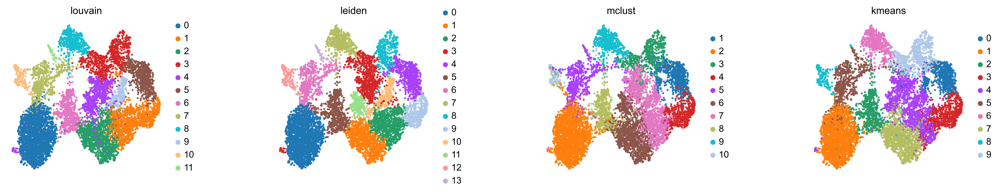

In [20]:
sc.pl.umap(adata_STAX, color=['louvain', 'leiden', 'mclust', 'kmeans'], wspace=0.5, size=30)

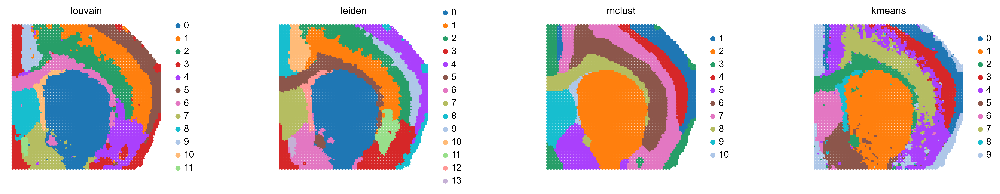

In [21]:
sc.pl.embedding(adata_STAX, color=['louvain', 'leiden', 'mclust', 'kmeans'], basis='spatial', wspace=0.5, size=30)

### Save result

In [22]:
del adata_STAX.uns['adj']

In [23]:
adata_STAX.write_h5ad(f'{path_results}adata_STAX.h5ad', compression='gzip')

## Transcriptomics, DLPFC with 12 slices

### To simplify the process, we use a loop to process each of the 12 slices

In [24]:
ARI_list = []
NMI_list = []
section_ids = [
                 '151507',
                 '151508',
                 '151509',
                 '151510',

                 '151673',
                 '151674',
                 '151675',
                 '151676',

                 '151669',
                 '151670',
                 '151671',
                 '151672',
]
cluster_num = [7, 7, 7, 7, 7, 7, 7, 7, 5, 5, 5, 5]
times = []
for i, section_id in enumerate(section_ids):
    print(section_id)
    # load data
    adata1 = sc.read_h5ad(f'./data/1single/DLPFC/{section_id}.h5ad')
    adata1.obs_names_make_unique()
    adata1.var_names_make_unique()
    data_list = [adata1]
    batch_key = 'batch'
    batch_names = ['adata1']
    # preprocess
    adata = sta.pp.process_adata(data_list, label=batch_key, keys=batch_names, n_top_features=5000, norm=True, scale='log', target_sum=1e4)
    # Construct graph
    rad_cutoff_list = [150]
    adata, g = sta.pp.process_graph(adata, data_list, cutoff_list=rad_cutoff_list)
    # Train
    path_results = f'./log/integration/'
    adata_STAX = sta.model.STAX(adata=adata,
                                n_epoch=300,
                                batch_size=len(adata),
                                verbose=False,
                                gpu=0,
                                random_seed=0,
                                output_dir=path_results,
                                )
    
    sta.tl.mclust_R(adata_STAX, used_embedding='X_STAX', n_clusters=cluster_num[i])
    adata_new = adata_STAX[~adata_STAX.obs.loc[:, 'Region'].isnull(), :]
    ari = ari_score(adata_new.obs['Region'], adata_new.obs['mclust'])
    nmi = normalized_mutual_info_score(adata_new.obs['Region'], adata_new.obs['mclust'])
    print('mclust, ARI = %01.3f' % ari)
    print('mclust, NMI = %01.3f' % nmi)
    ARI_list.append(ari)
    NMI_list.append(nmi)
    

151507
cal spatial net in data_list
------Calculating spatial graph...
The graph contains 24770 edges, 4226 cells.
5.8613 neighbors per cell on average.


Epochs: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 300/300 [00:14<00:00, 21.33it/s, recon_loss_mse=853.3777, kl_loss=5.2504, lr: 0.0]


fitting ...
  |======================================================================| 100%
mclust, ARI = 0.637
mclust, NMI = 0.725
151508
cal spatial net in data_list
------Calculating spatial graph...
The graph contains 25698 edges, 4384 cells.
5.8618 neighbors per cell on average.


Epochs: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 300/300 [00:14<00:00, 20.34it/s, recon_loss_mse=929.3130, kl_loss=5.2488, lr: 0.0]


fitting ...
  |======================================================================| 100%
mclust, ARI = 0.570
mclust, NMI = 0.696
151509
cal spatial net in data_list
------Calculating spatial graph...
The graph contains 28172 edges, 4789 cells.
5.8826 neighbors per cell on average.


Epochs: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 300/300 [00:15<00:00, 19.77it/s, recon_loss_mse=875.2043, kl_loss=4.8221, lr: 0.0]


fitting ...
  |======================================================================| 100%
mclust, ARI = 0.602
mclust, NMI = 0.684
151510
cal spatial net in data_list
------Calculating spatial graph...
The graph contains 27198 edges, 4634 cells.
5.8692 neighbors per cell on average.


Epochs: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 300/300 [00:15<00:00, 19.42it/s, recon_loss_mse=858.2475, kl_loss=4.7222, lr: 0.0]


fitting ...
  |======================================================================| 100%
mclust, ARI = 0.488
mclust, NMI = 0.602
151673
cal spatial net in data_list
------Calculating spatial graph...
The graph contains 21124 edges, 3639 cells.
5.8049 neighbors per cell on average.


Epochs: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 300/300 [00:14<00:00, 20.66it/s, recon_loss_mse=728.2828, kl_loss=5.1010, lr: 0.0]


fitting ...
  |======================================================================| 100%
mclust, ARI = 0.640
mclust, NMI = 0.732
151674
cal spatial net in data_list
------Calculating spatial graph...
The graph contains 21258 edges, 3673 cells.
5.7876 neighbors per cell on average.


Epochs: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 300/300 [00:14<00:00, 20.84it/s, recon_loss_mse=638.7867, kl_loss=4.7691, lr: 0.0]


fitting ...
  |======================================================================| 100%
mclust, ARI = 0.660
mclust, NMI = 0.745
151675
cal spatial net in data_list
------Calculating spatial graph...
The graph contains 20762 edges, 3592 cells.
5.7801 neighbors per cell on average.


Epochs: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 300/300 [00:13<00:00, 21.49it/s, recon_loss_mse=811.5928, kl_loss=5.5173, lr: 0.0]


fitting ...
  |======================================================================| 100%
mclust, ARI = 0.601
mclust, NMI = 0.706
151676
cal spatial net in data_list
------Calculating spatial graph...
The graph contains 20052 edges, 3460 cells.
5.7954 neighbors per cell on average.


Epochs: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 300/300 [00:14<00:00, 20.86it/s, recon_loss_mse=791.8329, kl_loss=5.0841, lr: 0.0]


fitting ...
  |======================================================================| 100%
mclust, ARI = 0.452
mclust, NMI = 0.579
151669
cal spatial net in data_list
------Calculating spatial graph...
The graph contains 21194 edges, 3661 cells.
5.7891 neighbors per cell on average.


Epochs: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 300/300 [00:13<00:00, 22.20it/s, recon_loss_mse=752.3160, kl_loss=4.6065, lr: 0.0]


fitting ...
  |======================================================================| 100%
mclust, ARI = 0.490
mclust, NMI = 0.614
151670
cal spatial net in data_list
------Calculating spatial graph...
The graph contains 20370 edges, 3498 cells.
5.8233 neighbors per cell on average.


Epochs: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 300/300 [00:14<00:00, 21.40it/s, recon_loss_mse=804.8428, kl_loss=4.7527, lr: 0.0]


fitting ...
  |======================================================================| 100%
mclust, ARI = 0.541
mclust, NMI = 0.579
151671
cal spatial net in data_list
------Calculating spatial graph...
The graph contains 24052 edges, 4110 cells.
5.8521 neighbors per cell on average.


Epochs: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 300/300 [00:15<00:00, 19.76it/s, recon_loss_mse=731.3157, kl_loss=4.5105, lr: 0.0]


fitting ...
  |======================================================================| 100%
mclust, ARI = 0.562
mclust, NMI = 0.678
151672
cal spatial net in data_list
------Calculating spatial graph...
The graph contains 23382 edges, 4015 cells.
5.8237 neighbors per cell on average.


Epochs: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 300/300 [00:15<00:00, 19.92it/s, recon_loss_mse=775.1342, kl_loss=4.6912, lr: 0.0]


fitting ...
  |======================================================================| 100%
mclust, ARI = 0.673
mclust, NMI = 0.723


In [25]:
np.mean(ARI_list), np.mean(NMI_list)

(0.5763349495763661, 0.6719173726215315)

## Translatomics, mouse_brain_dataset_2

### Load data

In [26]:
adata1 = sc.read_h5ad('./data/1single/mouse_brain_dataset_2.h5ad')
adata1

AnnData object with n_obs × n_vars = 60481 × 5413
    obs: 'X', 'Y', 'protocol', 'replicate', 'level_1', 'level_2', 'level_2_code', 'level_3', 'n_genes_by_counts', 'total_counts', 'cell_type'
    var: 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'level_2_colors', 'level_3_colors'
    obsm: 'spatial'

### Here, we use the normal pipeline to preprocess the count matrix

In [27]:
data_list = [adata1]
batch_key = 'batch'
batch_names = ['adata1']

In [28]:
adata = sta.pp.process_adata(data_list, label=batch_key, keys=batch_names, n_top_features=2500, norm=True, scale='log', target_sum=1e4)
adata

View of AnnData object with n_obs × n_vars = 60481 × 2500
    obs: 'X', 'Y', 'protocol', 'replicate', 'level_1', 'level_2', 'level_2_code', 'level_3', 'n_genes_by_counts', 'total_counts', 'cell_type', 'original_index', 'spot_quality', 'batch'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p'
    obsm: 'spatial'
    layers: 'counts', 'norm_log'

### Construct graph

In [29]:
k_cutoff_list = [450]
adata, g = sta.pp.process_graph(adata, data_list, cutoff_list=k_cutoff_list, max_neigh=200)

cal spatial net in data_list
------Calculating spatial graph...
The graph contains 843086 edges, 60481 cells.
13.9397 neighbors per cell on average.


### Train full batch

In [30]:
path_results = f'./log/rad450/'

In [32]:
adata_STAX = sta.model.STAX(adata=adata,
                            n_epoch=500,  # full batch
                            batch_size=len(adata),  # full batch
                            verbose=False,
                            gpu=0,
                            random_seed=42,
                            output_dir=path_results,
                            )

Epochs: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [02:52<00:00,  2.90it/s, recon_loss_mse=851.5964, kl_loss=4.6670, lr: 0.0]


In [33]:
adata_STAX

AnnData object with n_obs × n_vars = 60481 × 2500
    obs: 'X', 'Y', 'protocol', 'replicate', 'level_1', 'level_2', 'level_2_code', 'level_3', 'n_genes_by_counts', 'total_counts', 'cell_type', 'original_index', 'spot_quality', 'batch'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p', 'adj'
    obsm: 'spatial', 'X_STAX'
    varm: 'gene_embedding'
    layers: 'counts', 'norm_log', 'impute'

#### Be careful, if your GPU memory is not large enough to support full batch, you can use mini-batch for training. But the results may not be exactly consistent with the full batch.

In [40]:
adata_STAX = sta.model.STAX(adata=adata,
                            n_epoch=500 // 100,  # mini batch
                            batch_size=len(adata) // 100,  # mini batch
                            verbose=False,
                            gpu=0,
                            random_seed=42,
                            output_dir=path_results,
                            )

Epochs: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [01:12<00:00, 14.52s/it, recon_loss_mse=853.9293, kl_loss=5.0088, lr: 0.0]


In [41]:
adata_STAX

AnnData object with n_obs × n_vars = 60481 × 2500
    obs: 'X', 'Y', 'protocol', 'replicate', 'level_1', 'level_2', 'level_2_code', 'level_3', 'n_genes_by_counts', 'total_counts', 'cell_type', 'original_index', 'spot_quality', 'batch', 'leiden', 'louvain'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p', 'adj', 'neighbors', 'umap', 'leiden', 'louvain', 'leiden_colors', 'louvain_colors'
    obsm: 'spatial', 'X_STAX', 'X_umap'
    varm: 'gene_embedding'
    layers: 'counts', 'norm_log', 'impute'
    obsp: 'distances', 'connectivities'

### Clustering

In [42]:
sc.pp.neighbors(adata_STAX, use_rep='X_STAX')

In [43]:
sc.tl.umap(adata_STAX)

In [44]:
sc.tl.leiden(adata_STAX, resolution=0.3)

In [45]:
sc.tl.louvain(adata_STAX, resolution=0.5)

### Visualize Results of full batch

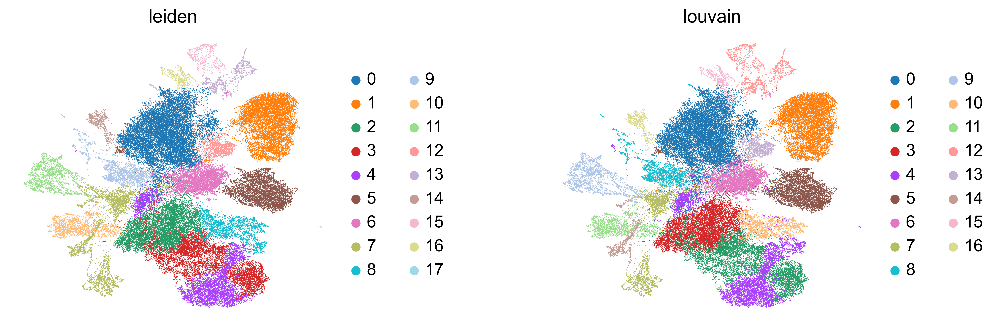

In [38]:
sc.pl.umap(adata_STAX, color=['leiden', 'louvain'], wspace=0.5)

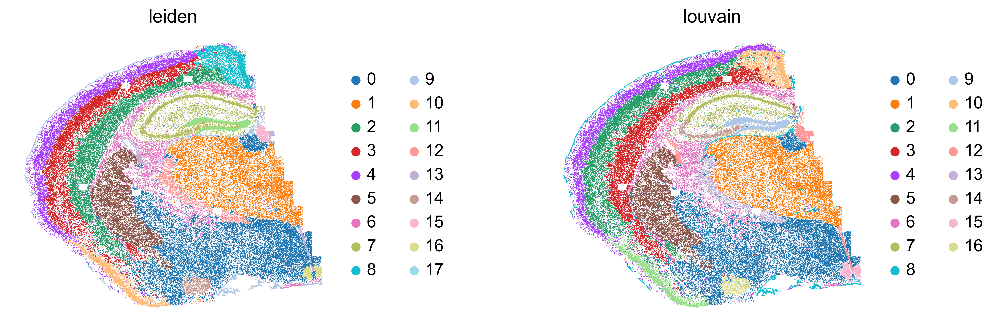

In [39]:
sc.pl.embedding(adata_STAX, basis='spatial', color=['leiden', 'louvain'], wspace=0.5)

### Visualize Results of mini batch

In [48]:
sc.tl.leiden(adata_STAX, resolution=0.2)

In [49]:
sc.tl.louvain(adata_STAX, resolution=0.4)

In [54]:
del adata_STAX.uns['leiden_colors']
del adata_STAX.uns['louvain_colors']

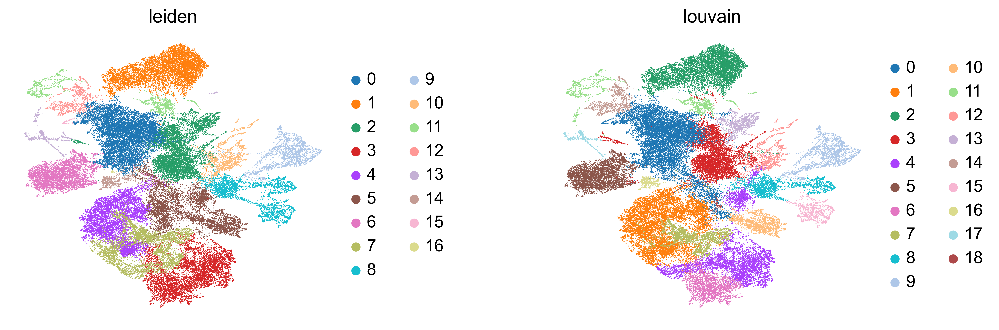

In [55]:
sc.pl.umap(adata_STAX, color=['leiden', 'louvain'], wspace=0.5)

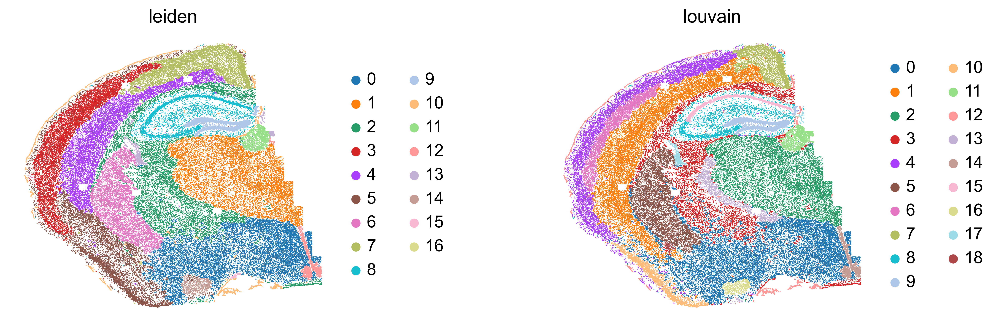

In [56]:
sc.pl.embedding(adata_STAX, basis='spatial', color=['leiden', 'louvain'], wspace=0.5)

### Save result

In [57]:
del adata_STAX.uns['adj']

In [58]:
adata_STAX.write_h5ad(f'{path_results}adata_STAX.h5ad', compression='gzip')

## Proteomics, mouse_spleen_dataset single

### Load data

In [59]:
adata = sc.read_h5ad(f'./data/1single/mouse_spleen_dataset1.h5ad')
adata.obs_names_make_unique()
adata.var_names_make_unique()
adata

AnnData object with n_obs × n_vars = 82251 × 30
    obs: 'x_coordinate', 'y_coordinate', 'CellType', 'Compartment', 'cell_type', 'domain', 'domain_id'
    uns: 'cell_type_colors', 'domain_colors'
    obsm: 'spatial'

### Here, we use "minmax" scale to preprocess expression matrix

In [60]:
adata.X.max(), adata.X.min()

(53697.68359375, -24924.759765625)

In [61]:
data_list = [adata]
batch_key = 'batch'
batch_names = ['adata']

adata = sta.pp.process_adata(data_list, label=batch_key, keys=batch_names, norm=False, scale='minmax')
adata

AnnData object with n_obs × n_vars = 82251 × 30
    obs: 'x_coordinate', 'y_coordinate', 'CellType', 'Compartment', 'cell_type', 'domain', 'domain_id', 'original_index', 'spot_quality', 'batch'
    obsm: 'spatial'
    layers: 'counts'

In [62]:
adata.X.max(), adata.X.min()

(10.000000000000002, 0.0)

### Construct graph

In [63]:
rad_cutoff_list = [50]
adata, g = sta.pp.process_graph(adata, data_list, cutoff_list=rad_cutoff_list, model='KNN')

cal spatial net in data_list
------Calculating spatial graph...
The graph contains 4112550 edges, 82251 cells.
50.0000 neighbors per cell on average.


### Train

In [64]:
path_results = f'./log/protein_sample1/'
adata_STAX = sta.model.STAX(adata=adata,
                            n_epoch=500 // 100,
                            batch_size=len(adata) // 100,
                            verbose=False,
                            gpu=0,
                            random_seed=42,
                            output_dir=path_results,
                            )

Epochs: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:55<00:00, 11.06s/it, recon_loss_mse=115.9487, kl_loss=1.7269, lr: 0.0]


### Clustering

In [65]:
sta.tl.kmeans_cluster(adata_STAX, mode='KMeans', used_embedding='X_STAX', n_clusters=4)

AnnData object with n_obs × n_vars = 82251 × 30
    obs: 'x_coordinate', 'y_coordinate', 'CellType', 'Compartment', 'cell_type', 'domain', 'domain_id', 'original_index', 'spot_quality', 'batch', 'kmeans'
    uns: 'adj'
    obsm: 'spatial', 'X_STAX'
    varm: 'gene_embedding'
    layers: 'counts', 'impute'

### The results of several clustering algorithms perform pretty well.

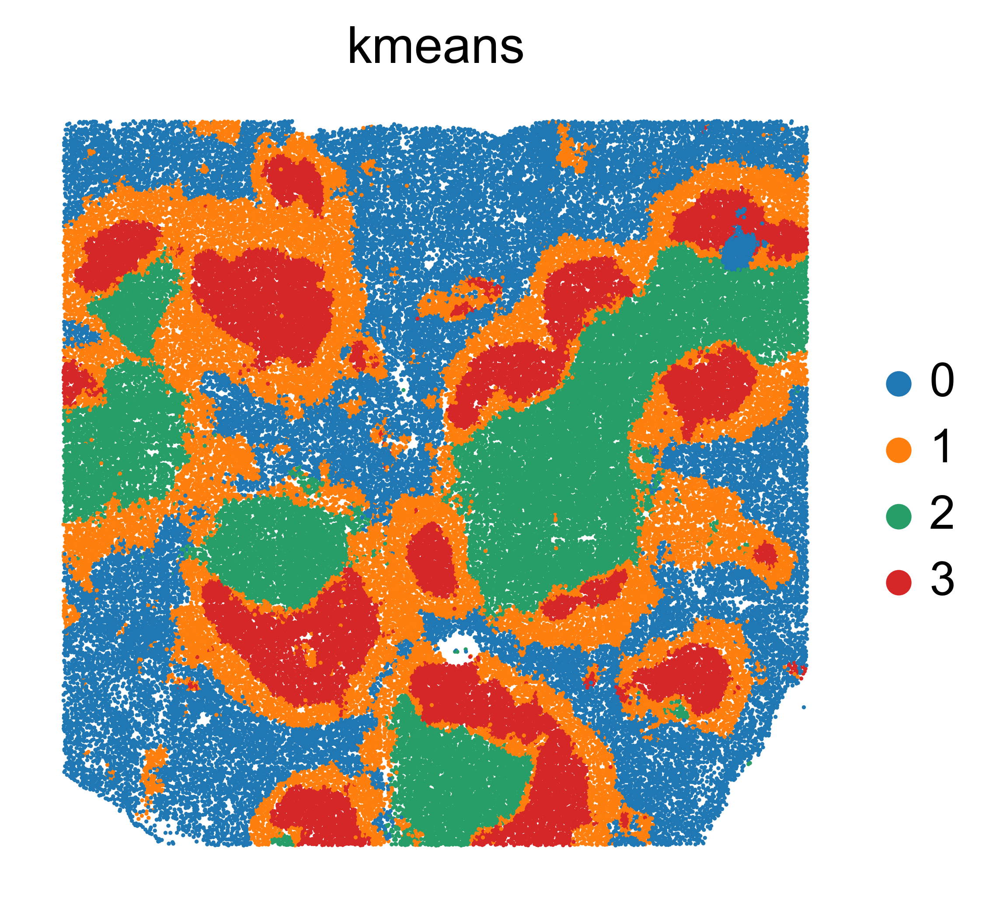

In [66]:
sc.pl.embedding(adata_STAX, color=['kmeans'], basis='spatial', size=5)

In [67]:
from sklearn.metrics import normalized_mutual_info_score
from sklearn.metrics import adjusted_rand_score
ari = adjusted_rand_score(adata_STAX.obs.loc[:, 'Compartment'], adata_STAX.obs.loc[:, 'kmeans'].astype(int))
print("ARI: ", ari)
nmi = normalized_mutual_info_score(adata_STAX.obs.loc[:, 'Compartment'], adata_STAX.obs.loc[:, 'kmeans'].astype(int))
print("NMI: ", nmi)

ARI:  0.5855748727705411
NMI:  0.5847716973608578


### Save result

In [68]:
del adata_STAX.uns['adj']

In [69]:
adata_STAX.write_h5ad(f'{path_results}adata_STAX.h5ad', compression='gzip')

## Metabolomics, pig_embryo_dataset

### Load data

In [76]:
adata1 = sc.read_h5ad(f'./data/1single/pig_embryo_dataset.h5ad')
adata1.obs_names_make_unique()
adata1.var_names_make_unique()
adata1

AnnData object with n_obs × n_vars = 4959 × 10200
    obsm: 'spatial'

### Here, we use the normal pipeline to preprocess the count matrix

In [77]:
data_list = [adata1]
batch_key = 'batch'
batch_names = ['adata1']

adata = sta.pp.process_adata(data_list, label=batch_key, keys=batch_names, norm=True, scale='log', target_sum=1e4, n_top_features=3000)
adata

View of AnnData object with n_obs × n_vars = 4959 × 3000
    obs: 'original_index', 'spot_quality', 'batch'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p'
    obsm: 'spatial'
    layers: 'counts', 'norm_log'

### Construct graph

In [78]:
rad_cutoff_list = [1.5]
adata, g = sta.pp.process_graph(adata, data_list, cutoff_list=rad_cutoff_list)

cal spatial net in data_list
------Calculating spatial graph...
The graph contains 38736 edges, 4959 cells.
7.8113 neighbors per cell on average.


### Train

In [79]:
path_results = f'./log/metabolism_pig/'

In [80]:
adata_STAX = sta.model.STAX(adata=adata,
                            n_epoch=500,
                            batch_size=len(adata),
                            verbose=False,
                            gpu=0,
                            random_seed=42,
                            output_dir=path_results,
                            )

Epochs: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [00:19<00:00, 25.06it/s, recon_loss_mse=402.3725, kl_loss=12.6823, lr: 0.0]


### Clustering

In [82]:
sc.pp.neighbors(adata_STAX, use_rep='X_STAX')

In [83]:
sc.tl.umap(adata_STAX)

In [84]:
sc.tl.louvain(adata_STAX, resolution=0.5)

In [90]:
sc.tl.leiden(adata_STAX, resolution=0.4)

### The results of several clustering algorithms perform pretty well.

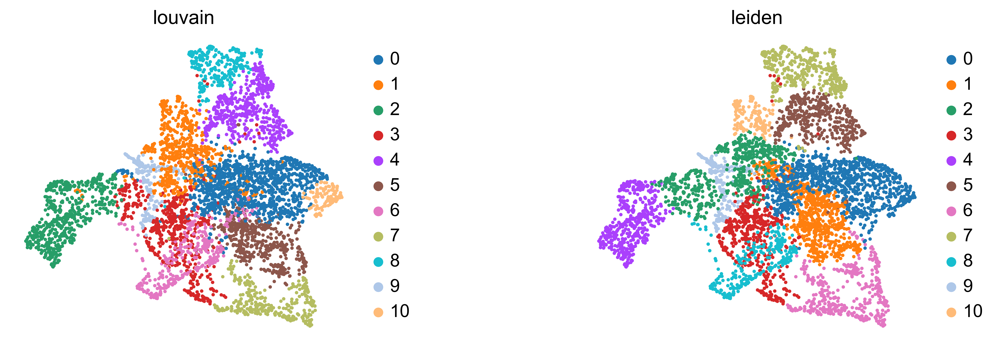

In [92]:
sc.pl.umap(adata_STAX, color=['louvain', 'leiden'], wspace=0.5)

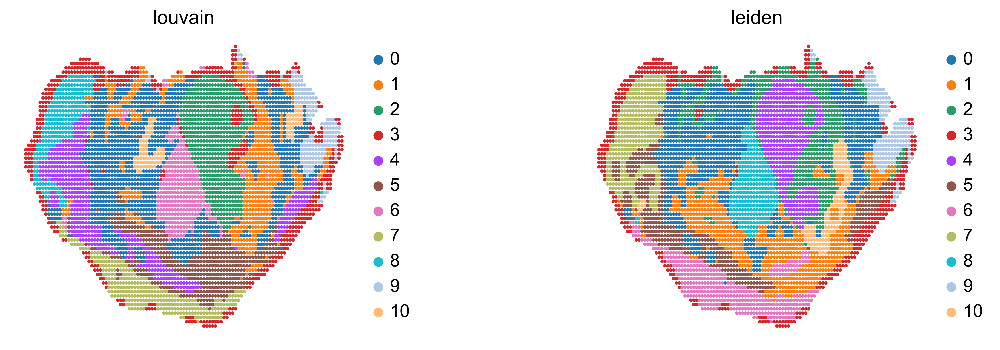

In [93]:
sc.pl.embedding(adata_STAX, color=['louvain', 'leiden'], basis='spatial', wspace=0.5)

### Save result

In [68]:
del adata_STAX.uns['adj']

In [95]:
adata_STAX.write_h5ad(f'{path_results}adata_STAX.h5ad', compression='gzip')